In [194]:
import numpy as np
import pandas as pd
import anndata as ad
import scanpy as sc
import matplotlib.pyplot as plt
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14
from matplotlib.gridspec import GridSpec

In [190]:
adata_F = sc.read_h5ad("adata-F-annotated.h5ad")

In [3]:
def MergeSubAdata(adata, subAdata, obsName, subObsName):
    obs = pd.Series(list(adata.obs[obsName].copy()), index=adata.obs_names)
    subObs = pd.Series(list(subAdata.obs[subObsName].copy()), index=subAdata.obs_names)
    obs.loc[subObs.index] = subObs
    return pd.DataFrame(obs, columns=[obsName])

def marker(adata, groupby, method='wilcoxon', prefix=''):
    sc.tl.rank_genes_groups(adata, groupby = groupby, method = method)
    sc.tl.dendrogram(adata, groupby=groupby, use_rep='X_pca_harmony')
    sc.pl.rank_genes_groups_dotplot(adata, groupby = groupby, save=prefix+groupby+'.svg')
    return adata

# 降维聚类
def clu(adata, key_added, n_neighbors=50, n_pcs=30, rep='X_pca_harmony', do_har=False, max_iter=20, resolution=1, do_scrublet=True):
    # Computing the neighborhood graph
    if do_scrublet:
        n0 = adata.shape[0]
        print("{0} Cell number: {1}".format(key_added, n0))
        sc.external.pp.scrublet(adata, random_state=112)
        adata = adata[adata.obs['predicted_doublet']==False,:].copy()
        print("{0} Cells retained after scrublet, {1} cells reomved.".format(adata.shape[0], n0-adata.shape[0]))
    else:
        print("Ignoring processing doublet cells...")
    sc.tl.pca(adata, svd_solver='arpack')
    if do_har:
        sc.external.pp.harmony_integrate(adata, key='batch',max_iter_harmony=max_iter)
    sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    # Run UMAP
    sc.tl.umap(adata)
    sc.tl.leiden(adata, key_added=key_added, resolution=resolution)
    sc.pl.umap(adata, color=key_added, legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc="on data")
    return adata

leiden-harmony-female Cell number: 228197


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.20
Detected doublet rate = 3.5%
Estimated detectable doublet fraction = 75.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.6%
220279 Cells retained after scrublet, 7918 cells reomved.


/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


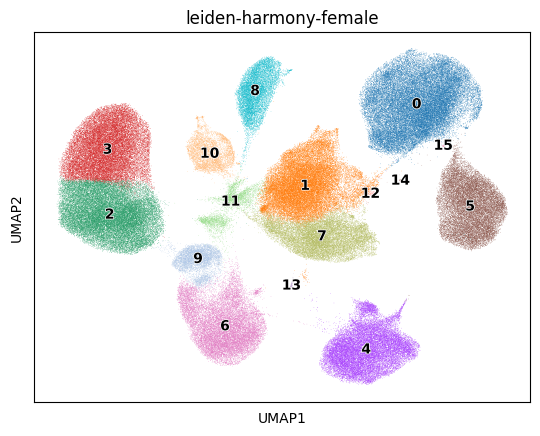

In [5]:
adata_F = clu(adata, key_added='leiden-harmony-female', resolution=0.5)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


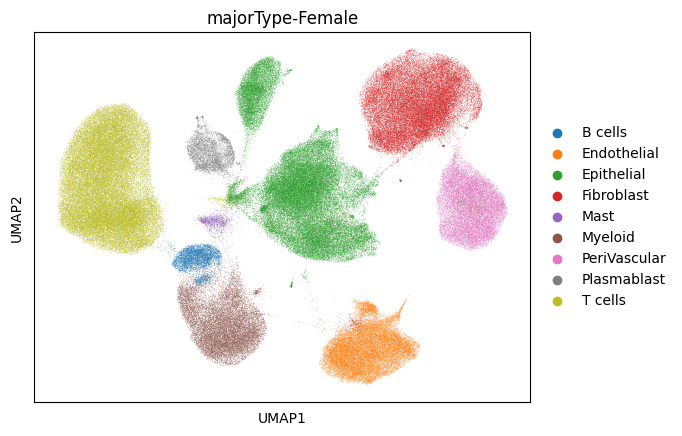

In [16]:
adata_F.obs['majorType-Female'] = list(adata_F.obs['major_type'])
# refine the annotation
adata_F.obs.loc[adata_F.obs['leiden-harmony-female']=='10', 'majorType-Female'] = 'Plasmablast'
adata_F.obs.loc[adata_F.obs['leiden-harmony-female']=='8', 'majorType-Female'] = 'Epithelial'
adata_F.obs.loc[adata_F.obs['leiden-harmony-female'].isin(['0', '15']), 'majorType-Female'] = 'Fibroblast'
adata_F.obs.loc[adata_F.obs['leiden-harmony-female'].isin(['1', '12', '14']), 'majorType-Female'] = 'Epithelial'
sc.pl.umap(adata_F, color='majorType-Female')

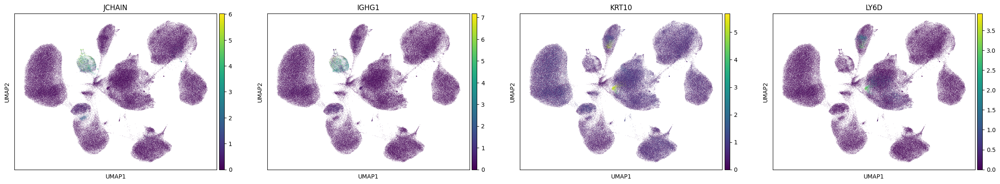

In [13]:
sc.pl.umap(adata_F, color=["JCHAIN", 'IGHG1', 'KRT10', 'LY6D'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


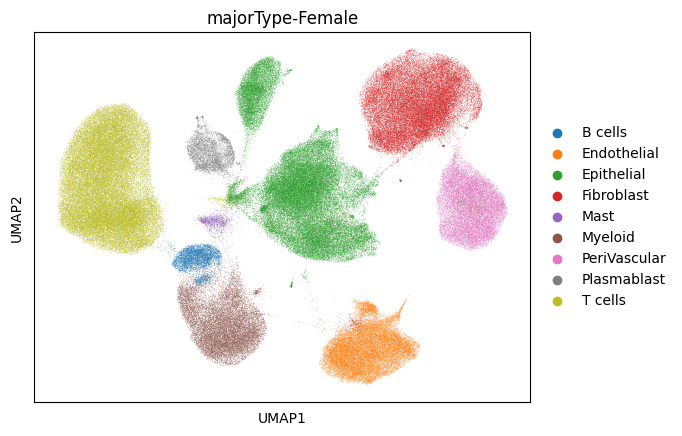

In [5]:
sc.pl.umap(adata_F, color='majorType-Female', title='BCY Major Types')

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


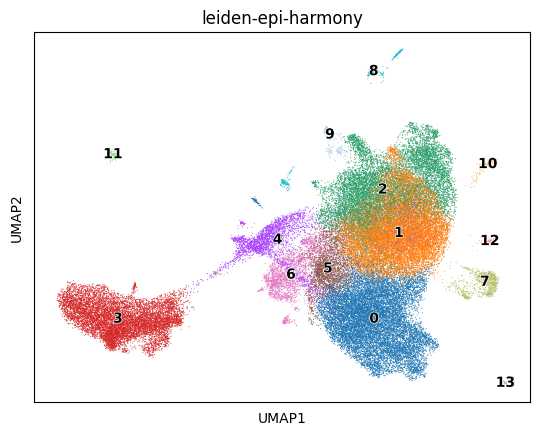

In [12]:
# epi
adata_F = adata
adata_epi =adata_F[adata_F.obs['majorType-Female']=='Epithelial']
adata_epi = clu(adata_epi, "leiden-epi-harmony", resolution=0.5, do_scrublet=False)

  0%|          | 0/12 [00:00<?, ?it/s]

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
... storing 'symbol' as categorical
... storing 'ensg' as categorical
... storing 'chromosome' as categorical


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


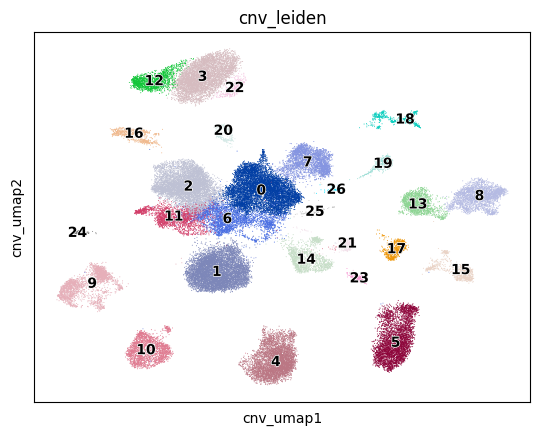

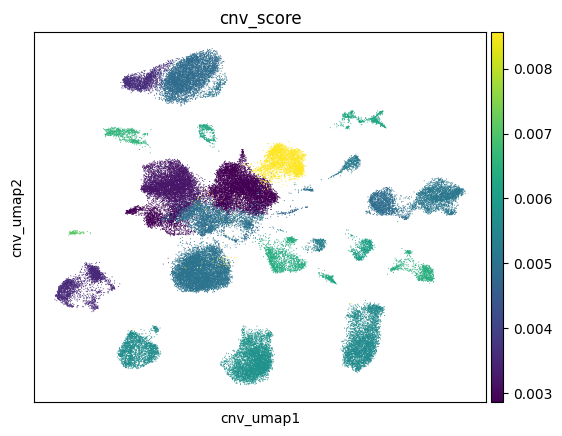

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


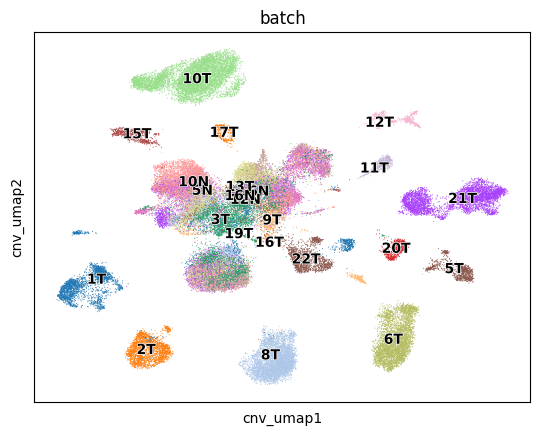

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


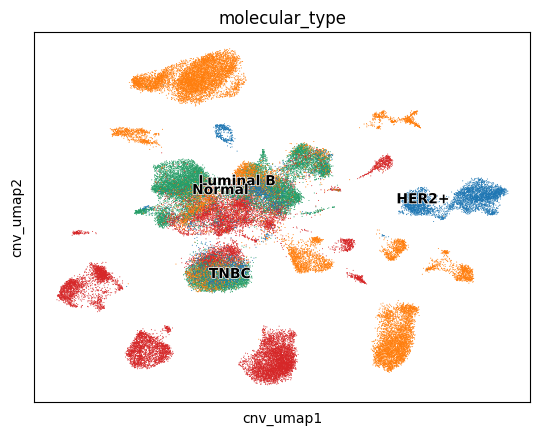

In [13]:
chrom = pd.read_csv("gene_pos.txt", sep='\t', header=None)
chrom.columns = ["symbol", "ensg", "chromosome", "start", "end"]
chrom.index = chrom['symbol']
chrom['ensg'] = [name.split('.')[0] for name in chrom['ensg']]
chrom_ensg = chrom.copy()
chrom_ensg.index = chrom_ensg['ensg']
var_names = list(adata_epi.var_names[adata_epi.var_names.isin(chrom['symbol']) + adata_epi.var_names.isin(chrom['ensg'])])
adata_epi_var = adata_epi[:, var_names]
for i in range(len(var_names)):
    name = var_names[i]
    if name in chrom_ensg['ensg']:
        var_names[i] = chrom_ensg['symbol'][name]
adata_epi_var.var_names = var_names
chrom_var_names = chrom.loc[var_names, :]
adata_epi_cnv = adata_epi[:, adata_epi.var_names.isin(chrom['symbol']) + adata_epi.var_names.isin(chrom['ensg'])]
adata_epi_cnv.var_names = var_names
adata_epi_cnv.var = pd.concat([adata_epi_var.var, chrom_var_names], axis=1)
adata_epi_cnv.var_names_make_unique()
import infercnvpy as cnv 
cnv.tl.infercnv(adata_epi_cnv,reference_key="molecular_type", reference_cat=['Normal'])
cnv.tl.pca(adata_epi_cnv) 
cnv.pp.neighbors(adata_epi_cnv) 
cnv.tl.leiden(adata_epi_cnv)
cnv.tl.umap(adata_epi_cnv) 
cnv.tl.cnv_score(adata_epi_cnv)
cnv.pl.umap(adata_epi_cnv, color="cnv_leiden", legend_loc='on data', legend_fontoutline=True,save='-epi-cnv-leiden-harmonyF.svg')
cnv.pl.umap(adata_epi_cnv, color="cnv_score",save='-epi-cnv-score-harmony1.svg')
cnv.pl.umap(adata_epi_cnv, color="batch", legend_loc='on data', legend_fontoutline=True,save='-epi-cnv-batch-harmonyF.svg')
cnv.pl.umap(adata_epi_cnv, color="molecular_type", legend_loc='on data', legend_fontoutline=True,save='-epi-molecular-harmonyF.svg')

... storing 'cnv_status' as categorical
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


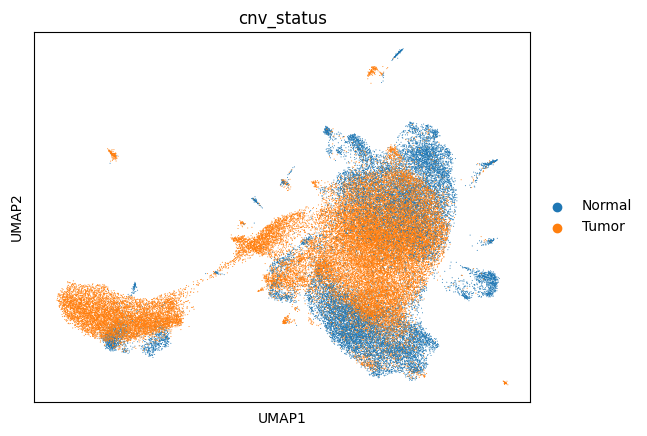

In [16]:
adata_epi_cnv.obs['cnv_status'] = 'Tumor'
adata_epi_cnv.obs.loc[adata_epi_cnv.obs['cnv_leiden'].isin(['0', '2', '11', '12', '9']), 'cnv_status'] = 'Normal'
adata_epi.obs['cnv_status'] = adata_epi_cnv.obs['cnv_status']
adata_epi.obs['cnv_score'] = adata_epi_cnv.obs['cnv_score']
sc.pl.umap(adata_epi, color='cnv_status')
sc.write("adata-Fepi.h5ad", adata_epi)

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
... storing 'cnv_status' as categorical
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


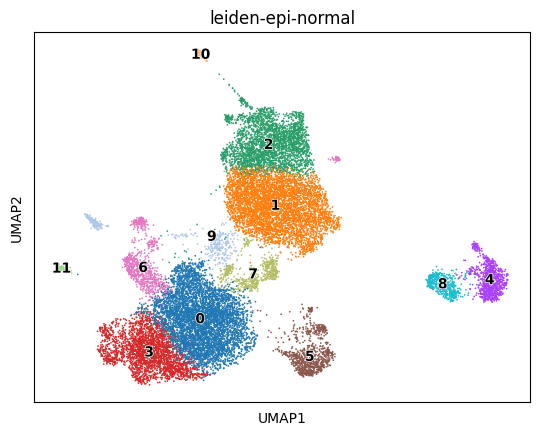

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


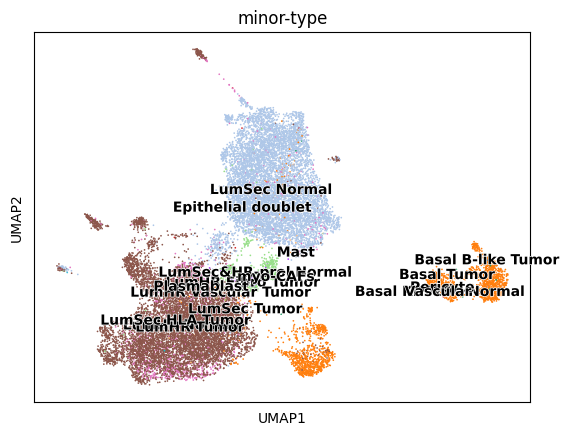

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


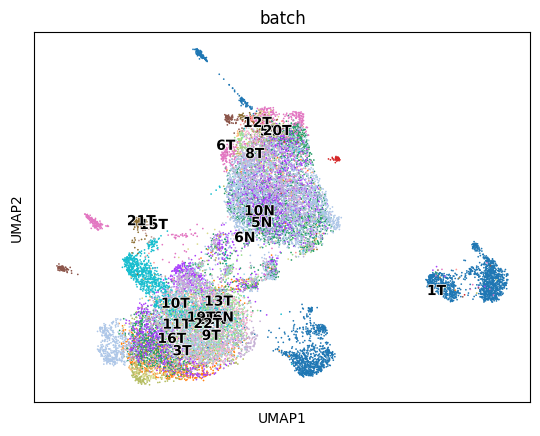

In [20]:
adata_epi_normal = adata_epi_cnv[adata_epi_cnv.obs['cnv_status']=='Normal']
adata_epi_normal = clu(adata_epi_normal, 'leiden-epi-normal', resolution=0.5, do_scrublet=False)
sc.pl.umap(adata_epi_normal, color="batch", legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc='on data')

... storing 'epi-type' as categorical
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


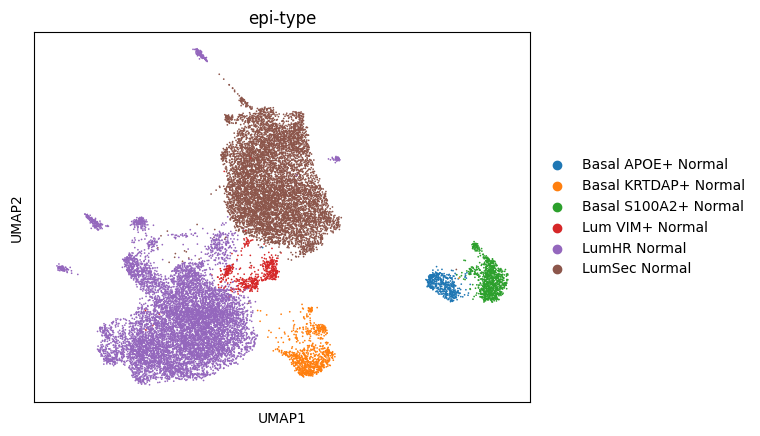

In [68]:
adata_epi_normal.obs['epi-type'] = 'Epi unassigned'
adata_epi_normal.obs.loc[  
    adata_epi_normal.obs["leiden-epi-normal"].isin(['4']), "epi-type"
] = "Basal S100A2+ Normal"

adata_epi_normal.obs.loc[  
    adata_epi_normal.obs["leiden-epi-normal"].isin(['8']), "epi-type"
] = "Basal APOE+ Normal"

adata_epi_normal.obs.loc[  
    adata_epi_normal.obs["leiden-epi-normal"].isin(['5']), "epi-type"
] = "Basal KRTDAP+ Normal"

adata_epi_normal.obs.loc[  
    adata_epi_normal.obs["leiden-epi-normal"].isin(['1', '2']), "epi-type"
] = "LumSec Normal"

adata_epi_normal.obs.loc[  
    adata_epi_normal.obs["leiden-epi-normal"].isin(['0', '3', '6', '9', '11', '10']), "epi-type"
] = "LumHR Normal"

adata_epi_normal.obs.loc[  
    adata_epi_normal.obs["leiden-epi-normal"].isin(['7']), "epi-type"
] = "Lum VIM+ Normal"
sc.pl.umap(adata_epi_normal, color='epi-type')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


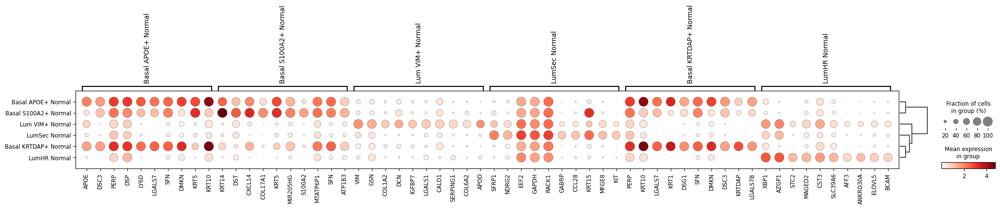

In [69]:
adata_epi_normal = marker(adata_epi_normal, 'epi-type')

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


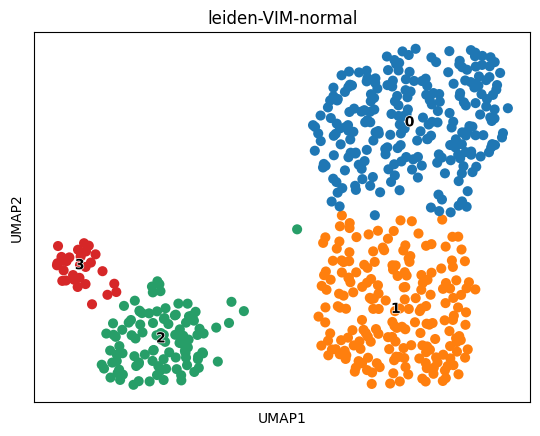

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


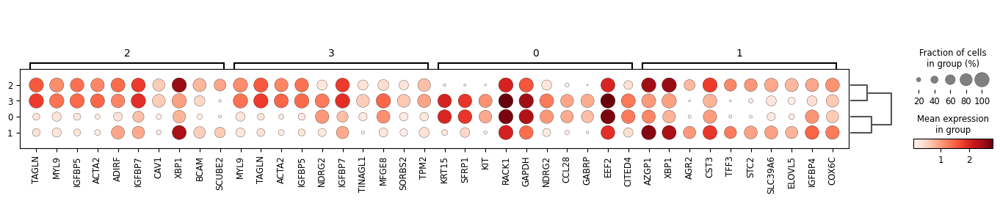

In [100]:
adata_vim_normal = adata_epi_normal[adata_epi_normal.obs['epi-type']=='Lum VIM+ Normal']
adata_vim_normal = clu(adata_vim_normal, 'leiden-VIM-normal', resolution=0.5, do_scrublet=False)
adata_vim_normal = marker(adata_vim_normal, 'leiden-VIM-normal')

In [111]:
adata_vim_normal.obs['LumVIM-type'] = 'LumVIM Major Normal'
adata_vim_normal.obs.loc[  
    adata_vim_normal.obs["leiden-VIM-normal"]=='0', "LumVIM-type"
] = "LumSec Fibro Normal"
adata_vim_normal.obs.loc[  
    adata_vim_normal.obs["leiden-VIM-normal"]=='1', "LumVIM-type"
] = "LumHR Fibro Normal"
adata_vim_normal.obs.loc[  
    adata_vim_normal.obs["leiden-VIM-normal"]=='2', "LumVIM-type"
] = "LumHR Vascular Normal"
adata_vim_normal.obs.loc[  
    adata_vim_normal.obs["leiden-VIM-normal"]=='3', "LumVIM-type"
] = "LumSec Vascular Normal"
adata_epi_normal.obs['epi-subtype']=MergeSubAdata(adata_epi_normal, adata_vim_normal, 'epi-subtype', 'LumVIM-type')

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


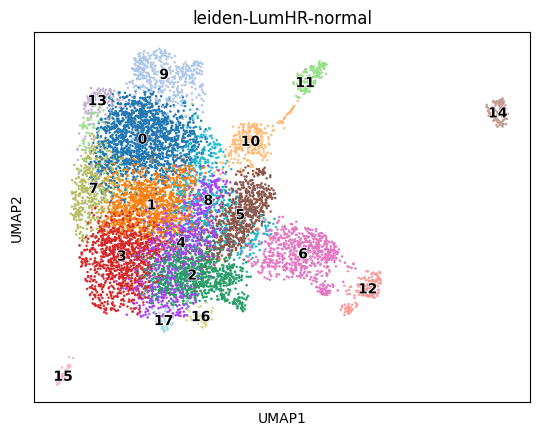

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


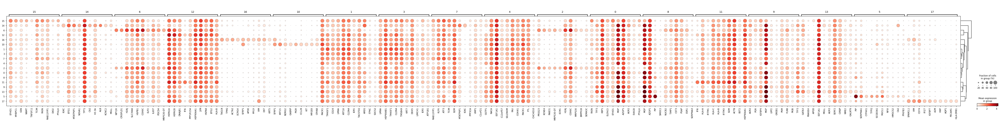

In [76]:
adata_lumHR_normal = adata_epi_normal[adata_epi_normal.obs['epi-type']=='LumHR Normal']
adata_lumHR_normal = clu(adata_lumHR_normal, 'leiden-LumHR-normal', resolution=1, do_scrublet=False)
adata_lumHR_normal = marker(adata_lumHR_normal, 'leiden-LumHR-normal')

... storing 'LumHR-type' as categorical


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


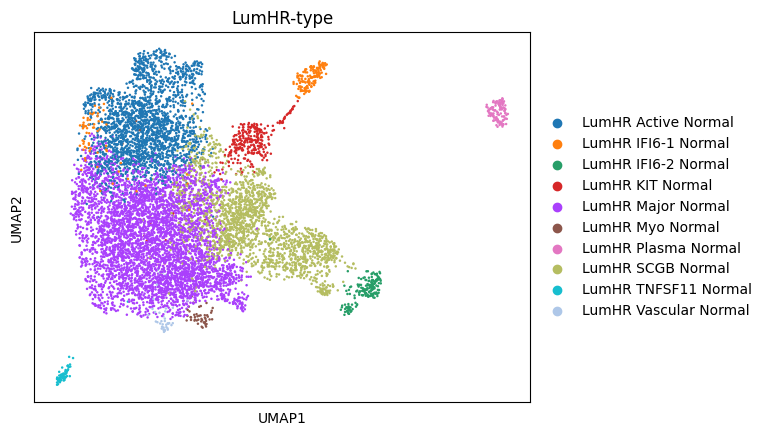

In [113]:
adata_lumHR_normal.obs['LumHR-type'] = 'LumHR Major Normal'
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['0','9','13']), "LumHR-type"
] = "LumHR Active Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['14']), "LumHR-type"
] = "LumHR Plasma Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['15']), "LumHR-type"
] = "LumHR TNFSF11 Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['2']), "LumHR-type"
] = "LumHR Major Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['6']), "LumHR-type"
] = "LumHR SCGB Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['11']), "LumHR-type"
] = "LumHR IFI6-1 Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['12']), "LumHR-type"
] = "LumHR IFI6-2 Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['16']), "LumHR-type"
] = "LumHR Myo Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['10']), "LumHR-type"
] = "LumHR KIT Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['5', '8']), "LumHR-type"
] = "LumHR SCGB Normal"
adata_lumHR_normal.obs.loc[  
    adata_lumHR_normal.obs["leiden-LumHR-normal"].isin(['17']), "LumHR-type"
] = "LumHR Vascular Normal"
sc.pl.umap(adata_lumHR_normal, color='LumHR-type')
# adata_epi_normal.obs['epi-subtype'] = adata_epi_normal.obs['epi-type']
adata_epi_normal.obs['epi-subtype'] = MergeSubAdata(adata_epi_normal, adata_lumHR_normal, 'epi-subtype', 'LumHR-type')

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


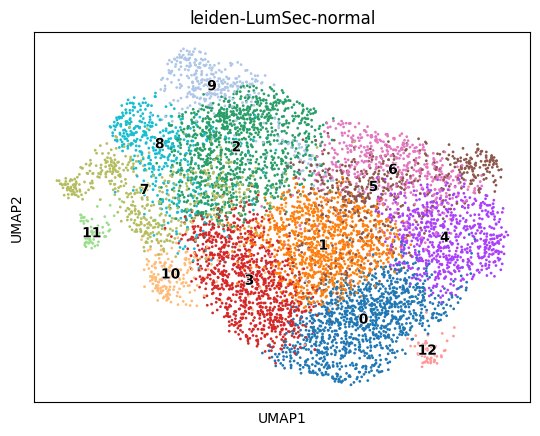

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


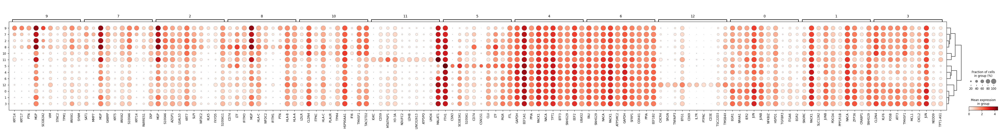

In [75]:
adata_lumSec_normal = adata_epi_normal[adata_epi_normal.obs['epi-type']=='LumSec Normal']
adata_lumSec_normal = clu(adata_lumSec_normal, 'leiden-LumSec-normal', resolution=1, do_scrublet=False)
adata_lumSec_normal = marker(adata_lumSec_normal, 'leiden-LumSec-normal')

... storing 'LumSec-type' as categorical
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


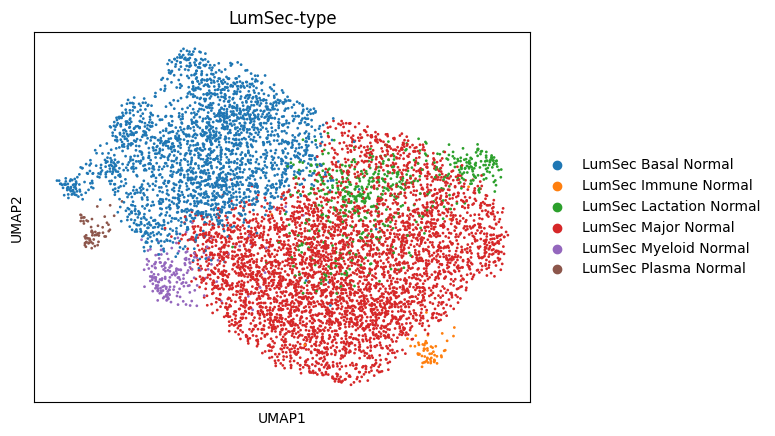

In [109]:
adata_lumSec_normal.obs['LumSec-type'] = 'LumSec Major Normal'
adata_lumSec_normal.obs.loc[  
    adata_lumSec_normal.obs["leiden-LumSec-normal"].isin(['5']), "LumSec-type"
] = "LumSec Lactation Normal"
adata_lumSec_normal.obs.loc[  
    adata_lumSec_normal.obs["leiden-LumSec-normal"].isin(['9', '2', '7', '8']), "LumSec-type"
] = "LumSec Basal Normal"
adata_lumSec_normal.obs.loc[  
    adata_lumSec_normal.obs["leiden-LumSec-normal"].isin(['10']), "LumSec-type"
] = "LumSec Myeloid Normal"
adata_lumSec_normal.obs.loc[  
    adata_lumSec_normal.obs["leiden-LumSec-normal"].isin(['11']), "LumSec-type"
] = "LumSec Plasma Normal"
adata_lumSec_normal.obs.loc[  
    adata_lumSec_normal.obs["leiden-LumSec-normal"].isin(['12']), "LumSec-type"
] = "LumSec Immune Normal"
sc.pl.umap(adata_lumSec_normal, color='LumSec-type')
adata_epi_normal.obs['epi-subtype'] = MergeSubAdata(adata_epi_normal, adata_lumSec_normal, 'epi-subtype', 'LumSec-type')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


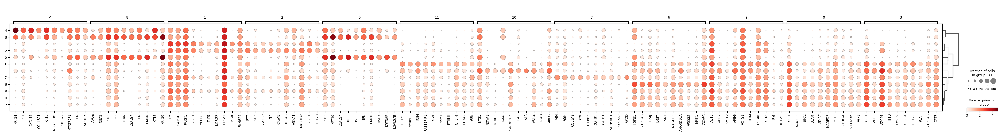

In [66]:
sc.pl.rank_genes_groups_dotplot(adata_epi_normal, groupby='leiden-epi-normal', save="-leiden-epiN.png")

... storing 'epi-subtype' as categorical
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


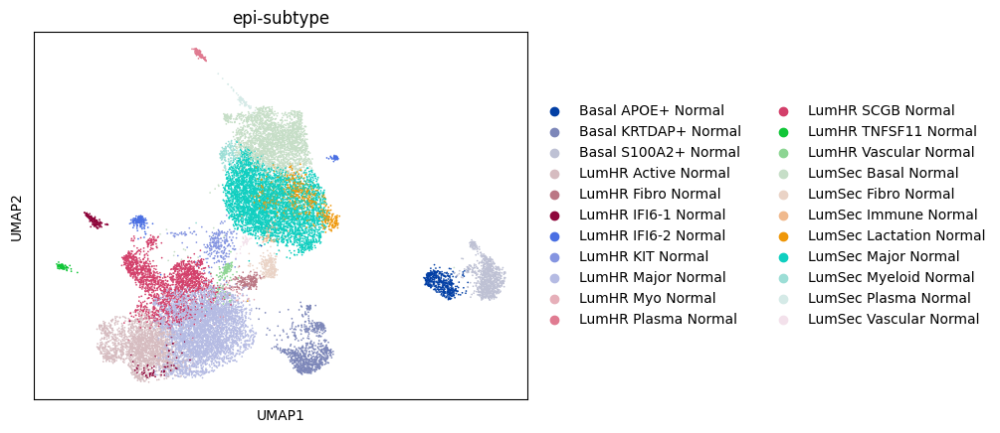

In [114]:
sc.pl.umap(adata_epi_normal, color='epi-subtype')

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


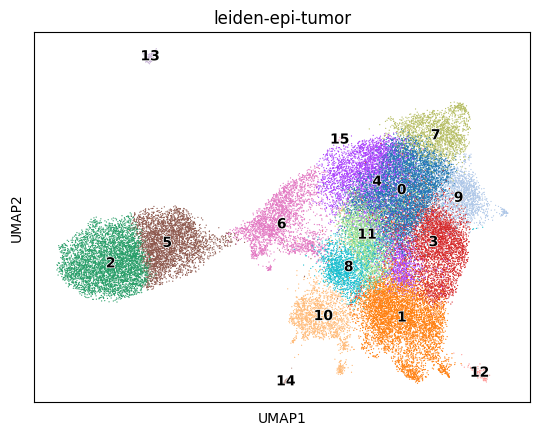

In [118]:
adata_epi_tumor = adata_epi[adata_epi_cnv.obs['cnv_status']=='Tumor']
adata_epi_tumor = clu(adata_epi_tumor, 'leiden-epi-tumor', resolution=0.8, do_scrublet=False)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


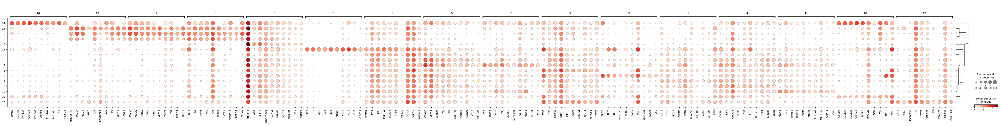

In [119]:
adata_epi_tumor = marker(adata_epi_tumor,"leiden-epi-tumor")

... storing 'tumor-type' as categorical
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


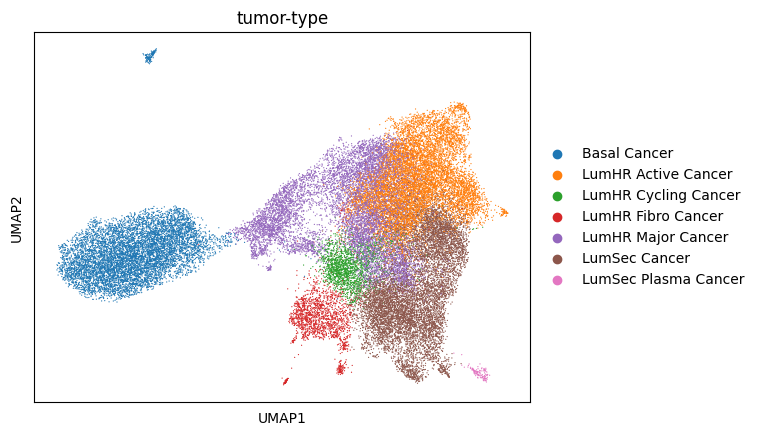

In [126]:
adata_epi_tumor.obs['tumor-type'] = 'Cancer Cells'
adata_epi_tumor.obs.loc[  
    adata_epi_tumor.obs["leiden-epi-tumor"].isin(['8']), "tumor-type"
] = "LumHR Cycling Cancer"
adata_epi_tumor.obs.loc[  
    adata_epi_tumor.obs["leiden-epi-tumor"].isin(['10', '14']), "tumor-type"
] = "LumHR Fibro Cancer"
adata_epi_tumor.obs.loc[  
    adata_epi_tumor.obs["leiden-epi-tumor"].isin(['0', '7', '9']), "tumor-type"
] = "LumHR Active Cancer"

adata_epi_tumor.obs.loc[  
    adata_epi_tumor.obs["leiden-epi-tumor"].isin(['4', '15', '11', '6']), "tumor-type"
] = "LumHR Major Cancer"
adata_epi_tumor.obs.loc[  
    adata_epi_tumor.obs["leiden-epi-tumor"].isin(['1', '3']), "tumor-type"
] = "LumSec Cancer"
adata_epi_tumor.obs.loc[  
    adata_epi_tumor.obs["leiden-epi-tumor"].isin(['2', '5', '13']), "tumor-type"
] = "Basal Cancer"
adata_epi_tumor.obs.loc[  
    adata_epi_tumor.obs["leiden-epi-tumor"].isin(['12']), "tumor-type"
] = "LumSec Plasma Cancer"
sc.pl.umap(adata_epi_tumor, color='tumor-type')

... storing 'epi-subtype' as categorical
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


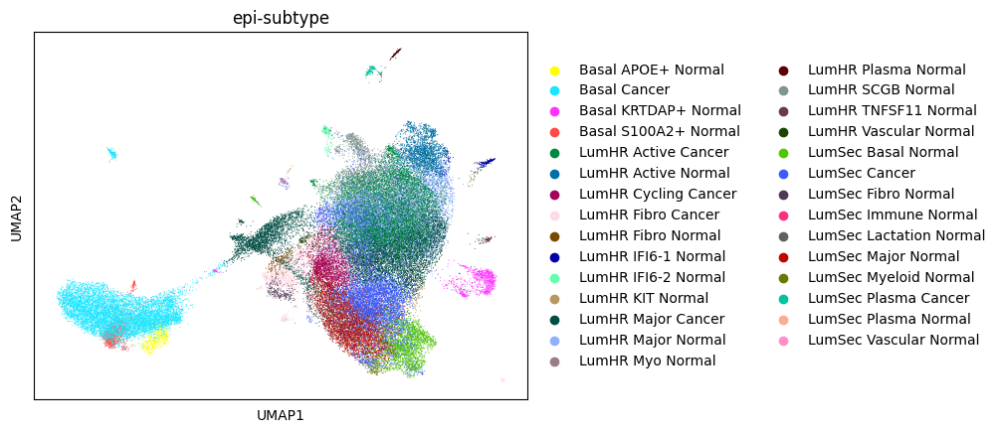

In [129]:
adata_epi.obs['epi-subtype']='Unassigned'
adata_epi.obs['epi-subtype'] = MergeSubAdata(adata_epi, adata_epi_normal, 'epi-subtype', 'epi-subtype')
adata_epi.obs['epi-subtype'] = MergeSubAdata(adata_epi, adata_epi_tumor, 'epi-subtype', 'tumor-type')
sc.pl.umap(adata_epi, color='epi-subtype')

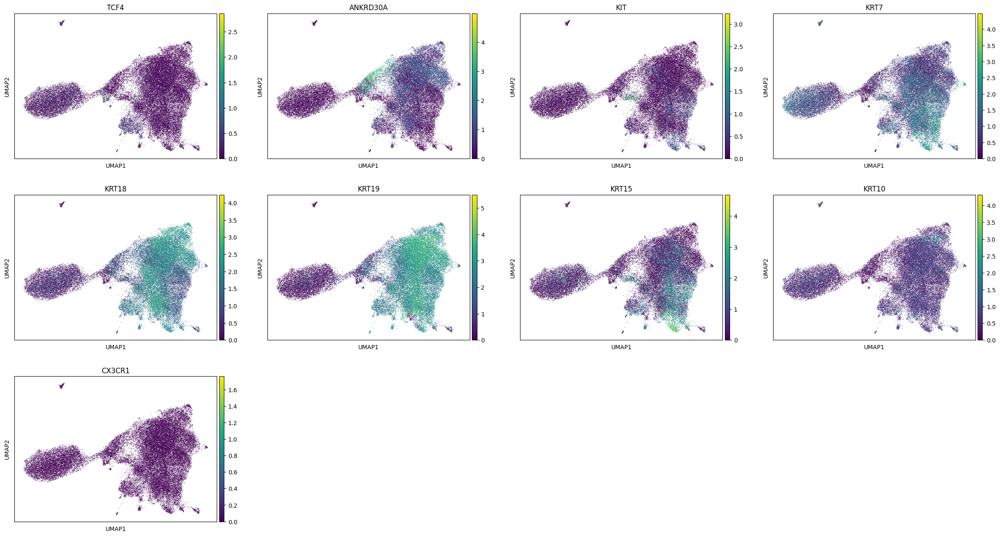

In [132]:
sc.pl.umap(adata_epi_tumor, color=['TCF4','ANKRD30A', 'KIT', 'KRT7', 'KRT18','KRT19', 'KRT15', 'KRT10', "CX3CR1"])

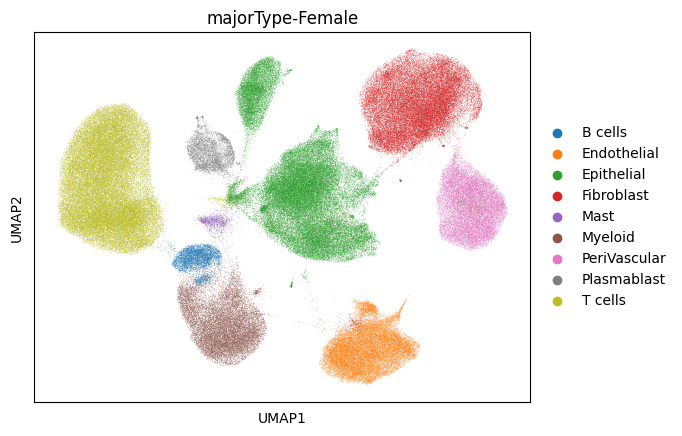

In [144]:
sc.pl.umap(adata_F, color="majorType-Female")

In [145]:
sc.write("adata-F-annotated.h5ad", adata_F)

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


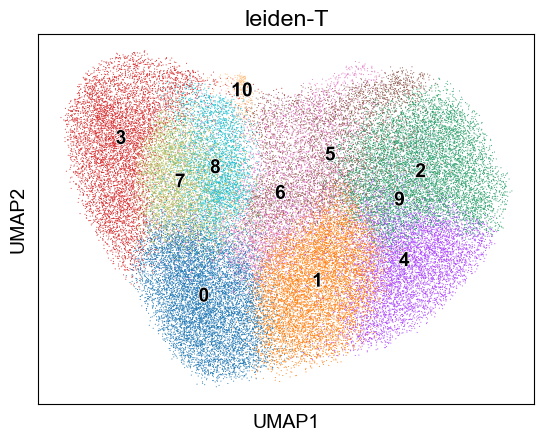

In [4]:
adata_T = adata_F[adata_F.obs['majorType-Female'] == 'T cells']
adata_T = clu(adata_T, 'leiden-T', resolution=1, do_scrublet=False)
adata_T.obs['CD4/CD8'] = 'CD4'
adata_T.obs.loc[  
    adata_T.obs["leiden-T"].isin(['1', '2', '4', '5', '6', '9']), "CD4/CD8"
] = "CD8"
adata_T.obs.loc[  
    adata_T.obs["leiden-T"].isin(['0', '3', '7', '8', '10']), "CD4/CD8"
] = "CD4"

In [7]:
adata_CD4 = adata_T[adata_T.obs['CD4/CD8']=='CD4']
# adata_CD8 = adata_T[adata_T.obs['CD4/CD8']=='CD8']
# adata_CD4 = clu(adata_CD4, 'leiden-CD4', resolution=1, do_har=True,do_scrublet=False, rep='X_pca_harmony')
# adata_CD8 = clu(adata_CD8, 'leiden-CD8', resolution=1, do_har=True,do_scrublet=False, rep='X_pca_harmony')
sc.tl.pca(adata_CD4, svd_solver='arpack')
sc.external.pp.harmony_integrate(adata_CD4, key='batch',max_iter_harmony=20)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
2024-01-24 02:46:03,042 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
OpenBLAS warning: precompiled NUM_THREADS exceeded, adding auxiliary array for thread metadata.


: 

: 

In [11]:
adata_CD4 = sc.read_h5ad('adata-T-CD4.h5ad')
adata_CD4 = adata_CD4[~adata_CD4.obs['batch'].isin(['4T-Male', '7N-Male', '14T-Male'])]
adata_CD4

View of AnnData object with n_obs × n_vars = 23371 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'leiden-T', 'T-type', 'leiden-T-CD4-harmony', 'leiden-T-CD4', 'leiden-T-CD4-0.5', 'T-CD4-type'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'T-type_colors', 'batch_colors', 'dendrogram_T-CD4-type', 'dendrogram_leiden', 'dendrogram_leiden-T-CD4', 'dendrogram_leiden-T-CD4-0.5', 'dendrogram_leiden-T-CD4-harmony', 'hvg', 'leiden', 'leiden-T-CD4-0.5_colors', 'leiden-T-CD4-harmony_colors', 'leiden-T-CD4_colors', 'leiden-T_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'major_type_colors', 'major_type_harmony_colors', 'neighbors', 'pca', 'rank

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


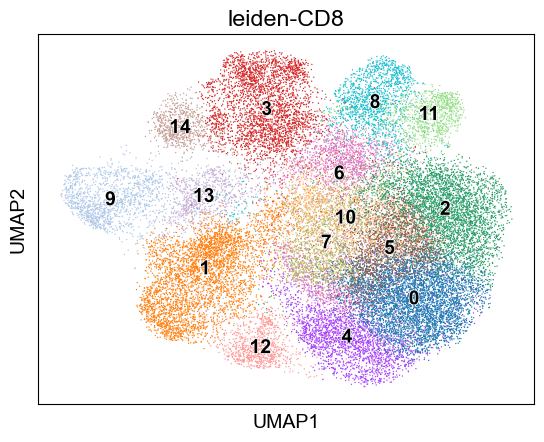

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


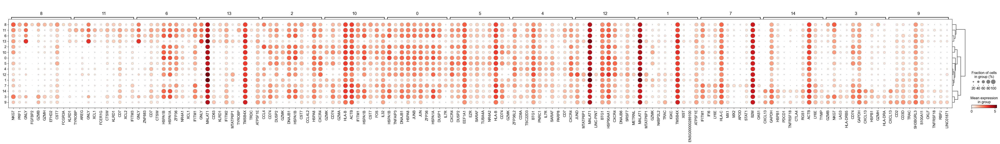

KeyError: 'Could not find key major-type in .var_names or .obs.columns.'

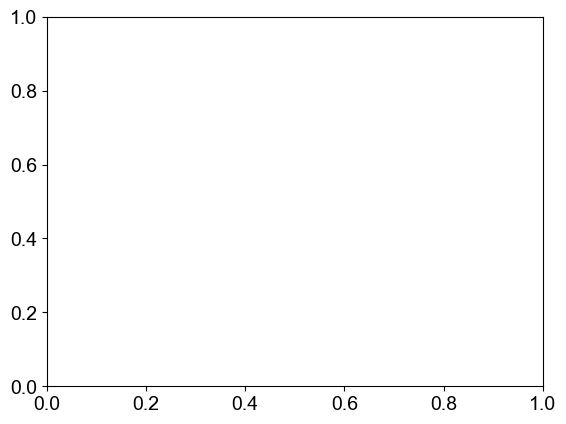

In [4]:
adata_CD8 = sc.read_h5ad('adata-T-CD8-annotated.h5ad')
adata_CD8 = adata_CD8[~adata_CD8.obs['batch'].isin(['4T-Male', '7N-Male', '14T-Male'])]
adata_CD8 = clu(adata_CD8, 'leiden-CD8', do_har=False, do_scrublet=False, rep='X_pca')
adata_CD8 = marker(adata_CD8, 'leiden-CD8')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


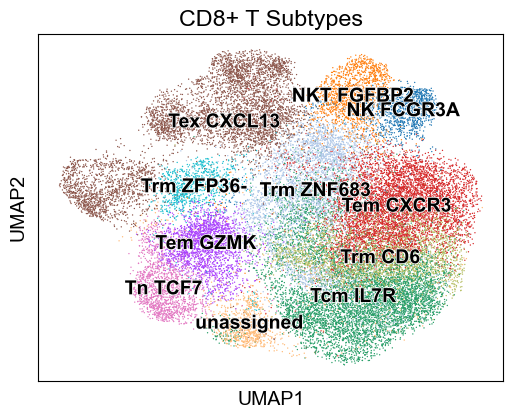

In [9]:
fig, ax=plt.subplots(figsize=(6, 4.5))
sc.pl.umap(adata_CD8, color='T-CD8-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='CD8+ T Subtypes')
fig.savefig('figure-1.23/CD8Type.png', dpi=300)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


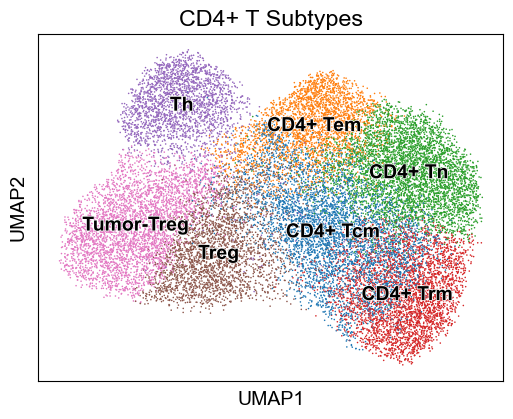

In [13]:
adata_CD4.obs['T-CD4-type'] = list(adata_CD4.obs['T-CD4-type'])
adata_CD4.obs.loc[adata_CD4.obs['T-CD4-type']=='Th1-like', 'T-CD4-type'] = 'Th'
fig, ax=plt.subplots(figsize=(6, 4.5))
sc.pl.umap(adata_CD4, color='T-CD4-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='CD4+ T Subtypes')
fig.savefig('figure-1.23/CD4Type.png', dpi=300)

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
2024-01-24 14:41:11,517 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-24 14:41:12,957 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-24 14:41:12,974 - harmonypy - INFO - Iteration 1 of 50
2024-01-24 14:41:13,395 - harmonypy - INFO - Iteration 2 of 50
2024-01-24 14:41:13,785 - harmonypy - INFO - Iteration 3 of 50
2024-01-24 14:41:14,082 - harmonypy - INFO - Iteration 4 of 50
2024-01-24 14:41:14,367 - harmonypy - INFO - Iteration 5 of 50
2024-01-24 14:41:14,655 - harmonypy - INFO - Iteration 6 of 50
2024-01-24 14:41:14,880 - harmonypy - INFO - Iteration 7 of 50
2024-01-24 14:41:15,088 - harmonypy - INFO - Iteration 8 of 50
2024-01-24 14:41:15,296 - harmonypy - INFO - Iteration 9 of 50
2024-01-24 14:41:15,505 - harmonypy - INFO - 

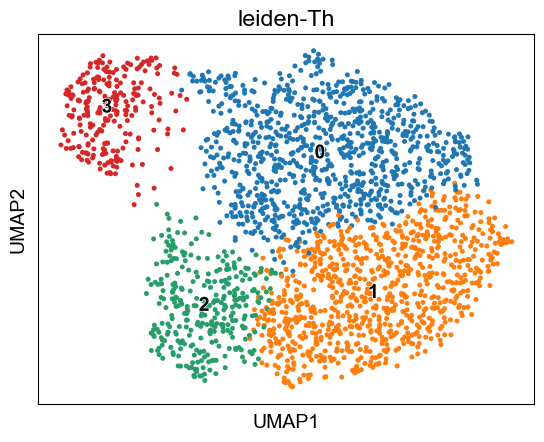

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


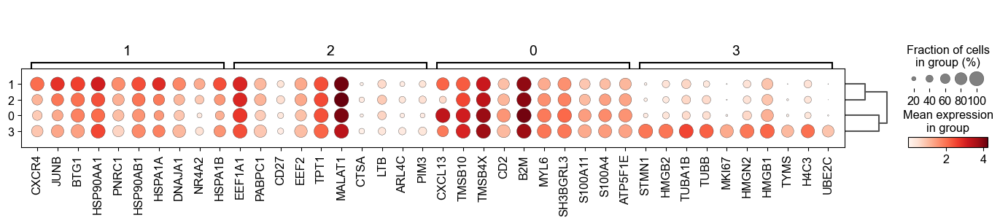

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


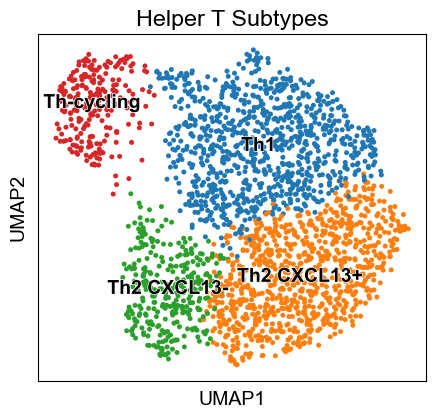

In [79]:
adata_Th = adata_CD4[adata_CD4.obs['T-CD4-type']=='Th']
adata_Th = clu(adata_Th, 'leiden-Th', do_scrublet=False, do_har=True, max_iter=50, resolution=0.5)
adata_Th = marker(adata_Th, 'leiden-Th')
adata_Th.obs['Th-type'] = 'CD4+ Th'
adata_Th.obs.loc[  
    adata_Th.obs["leiden-Th"].isin(['0']), "Th-type"
] = "Th1"
adata_Th.obs.loc[  
    adata_Th.obs["leiden-Th"].isin(['1']), "Th-type"
] = "Th2 CXCL13+"
adata_Th.obs.loc[  
    adata_Th.obs["leiden-Th"].isin(['2']), "Th-type"
] = "Th2 CXCL13-"
adata_Th.obs.loc[  
    adata_Th.obs["leiden-Th"].isin(['3']), "Th-type"
] = "Th-cycling"
fig, ax=plt.subplots(figsize=(5, 4.5))
sc.pl.umap(adata_Th, color='Th-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='Helper T Subtypes')
fig.savefig('figure-1.23/ThType.png', dpi=300)

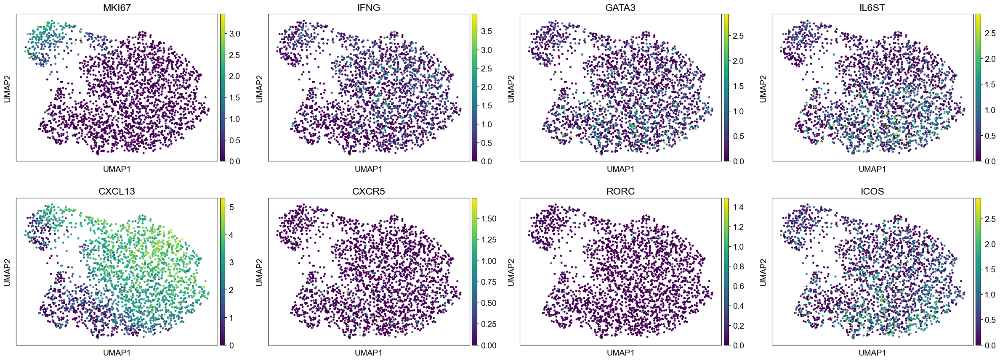

In [77]:
sc.pl.umap(adata_Th, color=['MKI67', 'IFNG', 'GATA3', 'IL6ST', 'CXCL13', 'CXCR5', 'RORC', 'ICOS'], save='Tfhmarker.png')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


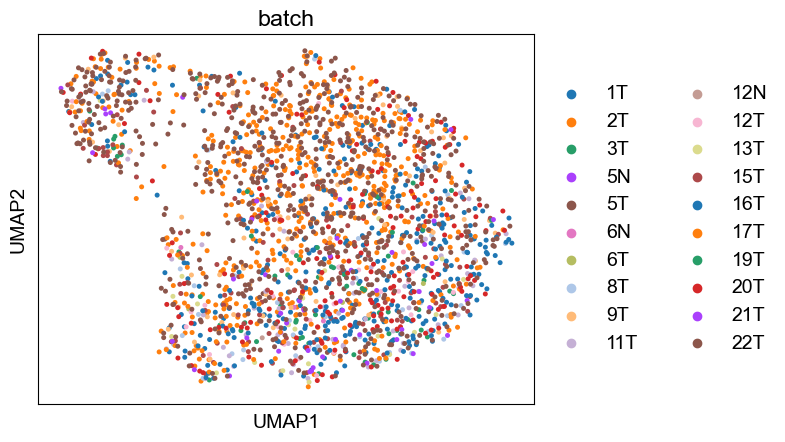

In [40]:
sc.pl.umap(adata_Tfh, color=['batch'])

Ignoring processing doublet cells...


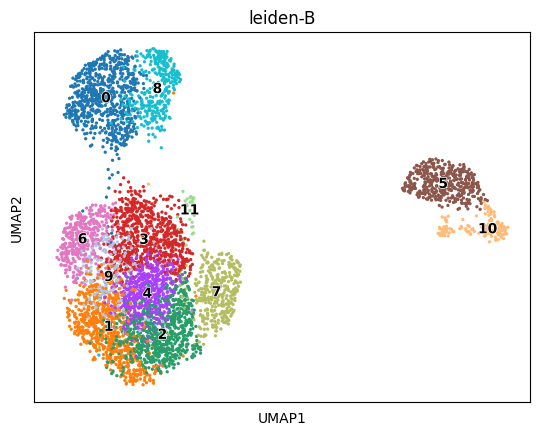

Ignoring processing doublet cells...


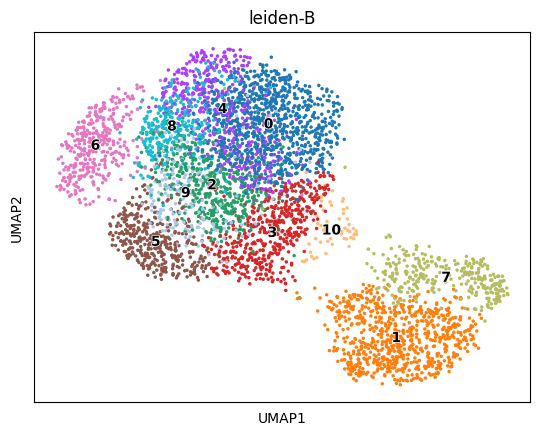

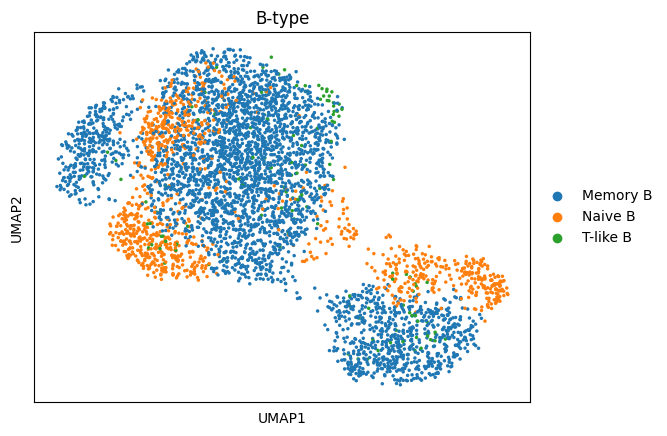

In [192]:
adata_B = adata_F[adata_F.obs['majorType-Female'] == 'B cells']

adata_B = clu(adata_B, 'leiden-B', resolution=1, do_scrublet=False, rep='X_pca')
adata_pdc = adata_B[adata_B.obs["leiden-B"].isin(['5', '10'])]
adata_B = adata_B[~adata_B.obs["leiden-B"].isin(['5', '10'])]
adata_B = clu(adata_B, 'leiden-B', resolution=1, do_scrublet=False, rep='X_pca')
adata_B.obs['B-type'] = 'Memory B'
adata_B.obs.loc[  
    adata_B.obs["leiden-B"].isin(['8', '7', '10', '5']), "B-type"
] = "Naive B"
adata_B.obs.loc[  
    adata_B.obs["minor-type"].isin(['T-like B cells']), "B-type"
] = "T-like B"
sc.pl.umap(adata_B, color='B-type')

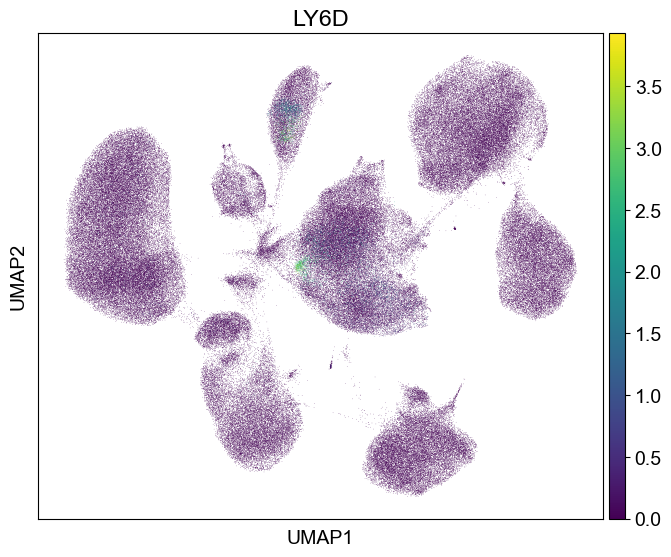

In [70]:
fig, ax=plt.subplots(figsize=(8, 6.3))
sc.pl.umap(adata_F, color=['LY6D'], ax=ax)
fig.savefig('figure-1.23/LY6D.png', dpi=300)

Ignoring processing doublet cells...


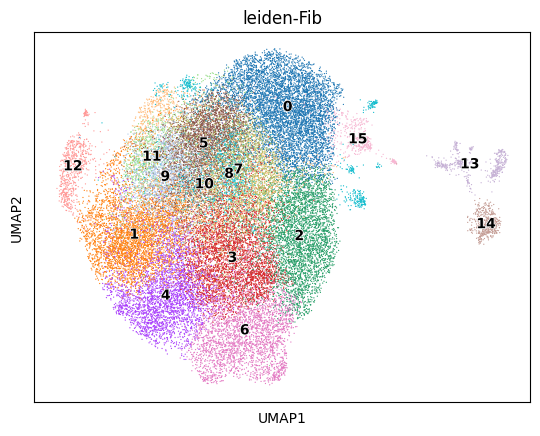

... storing 'Fib-type' as categorical


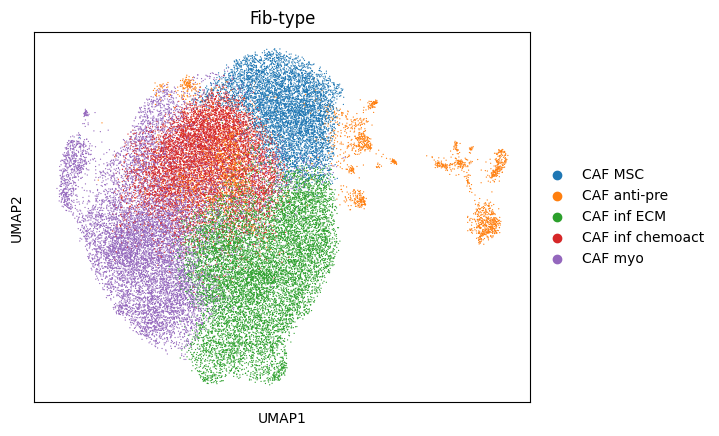

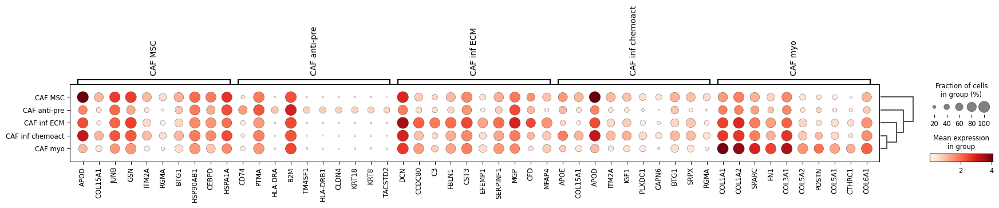

In [250]:
adata_Fib = adata_F[adata_F.obs['majorType-Female'] == 'Fibroblast']
adata_Fib = clu(adata_Fib, 'leiden-Fib', resolution=1, do_scrublet=False, rep='X_pca_harmony')
adata_Fib.obs['Fib-type'] = 'Fibroblast'
adata_Fib.obs.loc[  
    adata_Fib.obs["leiden-Fib"].isin(['1', '4', '10', '12', '11']), "Fib-type"
] = "CAF myo"
adata_Fib.obs.loc[  
    adata_Fib.obs["leiden-Fib"].isin(['2', '3', '6']), "Fib-type"
] = "CAF inf ECM"
adata_Fib.obs.loc[  
    adata_Fib.obs["leiden-Fib"].isin(['8', '13', '14', '15']), "Fib-type"
] = "CAF anti-pre"
adata_Fib.obs.loc[  
    adata_Fib.obs["leiden-Fib"].isin(['5', '7', '9']), "Fib-type"
] = "CAF inf chemoact"
adata_Fib.obs.loc[  
    adata_Fib.obs["leiden-Fib"].isin(['0']), "Fib-type"
] = "CAF MSC"
sc.pl.umap(adata_Fib, color='Fib-type')
adata_Fib = marker(adata_Fib, 'Fib-type')

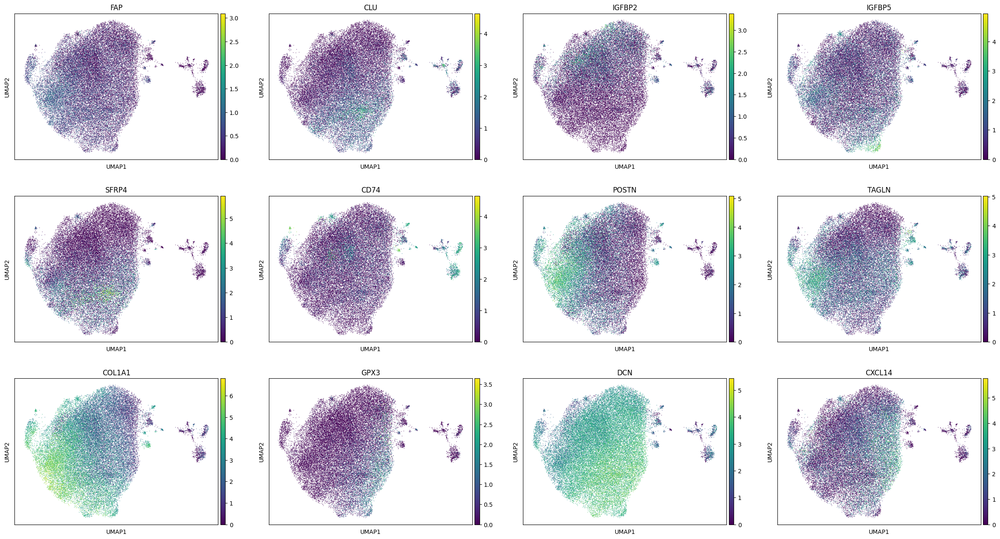

In [253]:
sc.pl.umap(adata_Fib, color=['FAP', 'CLU','IGFBP2', 'IGFBP5', 'SFRP4', 'CD74',
                              'POSTN', 'TAGLN', 'COL1A1', 'GPX3', 'DCN', 'CXCL14'])
sc.write("adata-FFib.h5ad", adata_Fib)

/tmp/ipykernel_163442/2041985627.py:2: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_Mye = adata_Mye.concatenate(adata_pdc)


Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


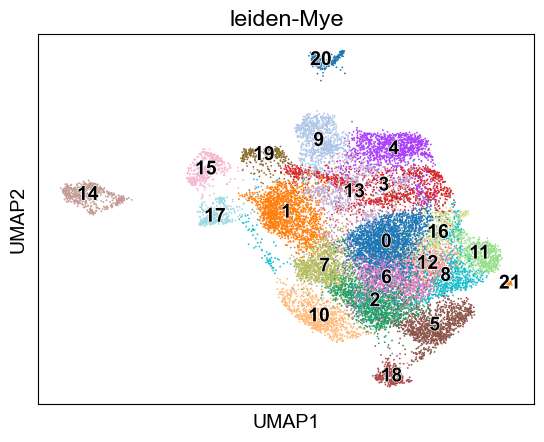

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame is highly fragmented.  This is usually t

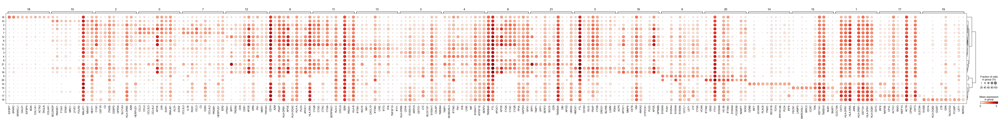

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


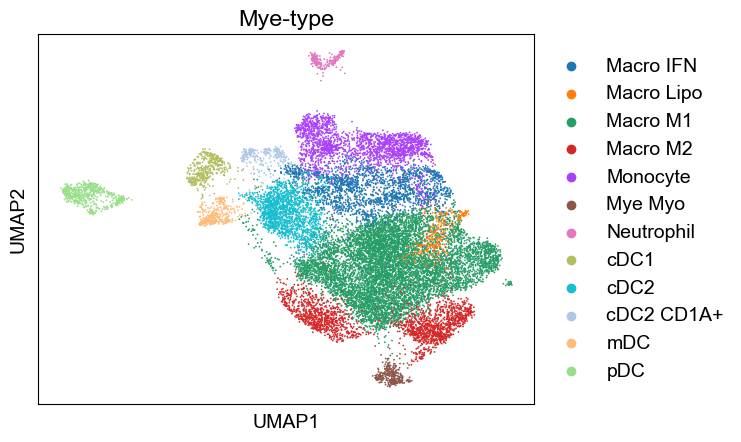

In [38]:
adata_Mye = adata_F[adata_F.obs['majorType-Female'] == 'Myeloid']
adata_Mye = adata_Mye.concatenate(adata_pdc)
adata_Mye = clu(adata_Mye, 'leiden-Mye', resolution=1, do_scrublet=False, rep='X_pca')
adata_Mye = marker(adata_Mye, 'leiden-Mye')
adata_Mye.obs['Mye-type'] = 'Myeloid'
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['20']), "Mye-type"
] = "Neutrophil"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['4', '9']), "Mye-type"
] = "Monocyte"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['0', '2', '8', '7', '6', '11', '12', '21']), "Mye-type"
] = "Macro M1"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['5', '10']), "Mye-type"
] = "Macro M2"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['16']), "Mye-type"
] = "Macro Lipo"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['3', '13']), "Mye-type"
] = "Macro IFN"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['17']), "Mye-type"
] = "mDC"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['15']), "Mye-type"
] = "cDC1"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['1']), "Mye-type"
] = "cDC2"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['19']), "Mye-type"
] = "cDC2 CD1A+"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['14']), "Mye-type"
] = "pDC"
adata_Mye.obs.loc[  
    adata_Mye.obs["leiden-Mye"].isin(['18']), "Mye-type"
] = "Mye Myo"
sc.pl.umap(adata_Mye, color='Mye-type')
sc.write('adata-Fmye.h5ad', adata_Mye)

In [36]:
adata_pdc

View of AnnData object with n_obs × n_vars = 562 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-B'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'dendrogram_leiden', 'gender_colors', 'hvg', 'leiden', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'minor_type_colors', 'molecular_type_colors', 'neighbors', 'pca', 'rank_genes_groups', 'scrublet

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


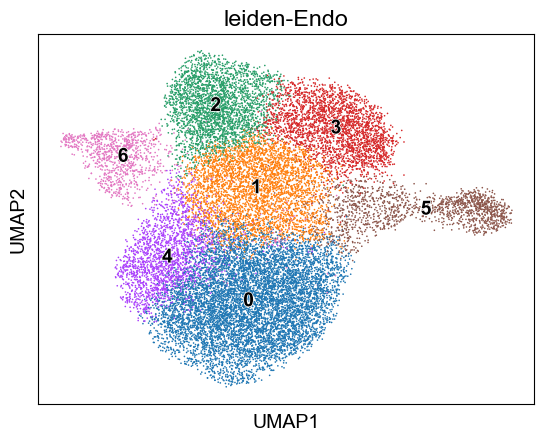

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


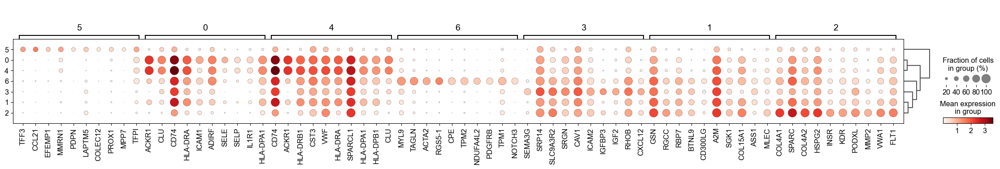

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


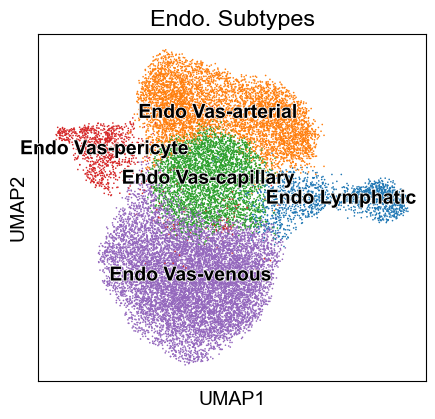

In [103]:
adata_Endo = adata_F[adata_F.obs['majorType-Female'] == 'Endothelial']
adata_Endo = clu(adata_Endo, 'leiden-Endo', resolution=0.5, do_scrublet=False)
adata_Endo = marker(adata_Endo, 'leiden-Endo')
adata_Endo.obs['Endo-type'] = 'Endothelial'
adata_Endo.obs.loc[  
    adata_Endo.obs["leiden-Endo"].isin(['2','3']), "Endo-type"
] = "Endo Vas-arterial"
adata_Endo.obs.loc[  
    adata_Endo.obs["leiden-Endo"].isin(['1']), "Endo-type"
] = "Endo Vas-capillary"
adata_Endo.obs.loc[  
    adata_Endo.obs["leiden-Endo"].isin(['0', '4']), "Endo-type"
] = "Endo Vas-venous"
adata_Endo.obs.loc[  
    adata_Endo.obs["leiden-Endo"].isin(['6']), "Endo-type"
] = "Endo Vas-pericyte"
adata_Endo.obs.loc[  
    adata_Endo.obs["leiden-Endo"].isin(['5']), "Endo-type"
] = "Endo Lymphatic"
folder='figure-1.23/'
fig,ax = plt.subplots(figsize=(5,4.5))
sc.pl.umap(adata_Endo, color='Endo-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='Endo. Subtypes')
fig.savefig(folder+"endoType.png", dpi=300)


Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


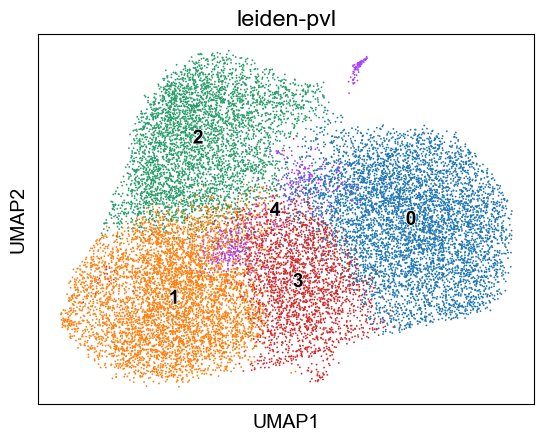

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


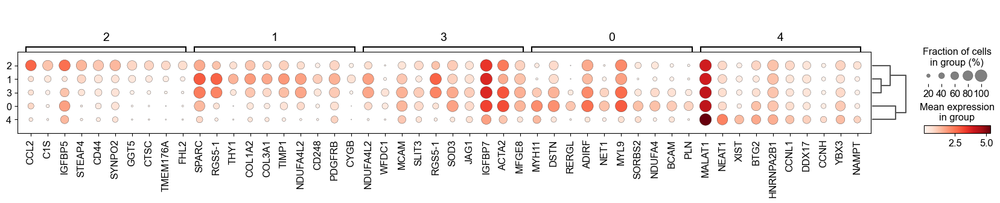

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


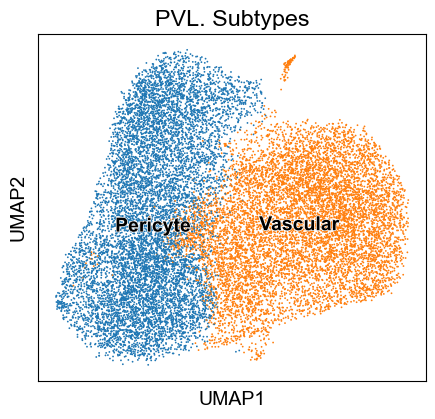

In [104]:
adata_pvl = adata_F[adata_F.obs['majorType-Female'] == 'PeriVascular']
adata_pvl = clu(adata_pvl, 'leiden-pvl', resolution=0.5, do_scrublet=False, rep='X_pca_harmony')
adata_pvl = marker(adata_pvl, 'leiden-pvl')
adata_pvl.obs['pvl-type'] = 'PeriVascular'
adata_pvl.obs.loc[  
    adata_pvl.obs["leiden-pvl"].isin(['0', '3', '4']), "pvl-type"
] = "Vascular"
adata_pvl.obs.loc[  
    adata_pvl.obs["leiden-pvl"].isin(['1', '2']), "pvl-type"
] = "Pericyte"
folder='figure-1.23/'
fig,ax = plt.subplots(figsize=(5,4.5))
sc.pl.umap(adata_pvl, color='pvl-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='PVL. Subtypes')
fig.savefig(folder+"pvlType.png", dpi=300)

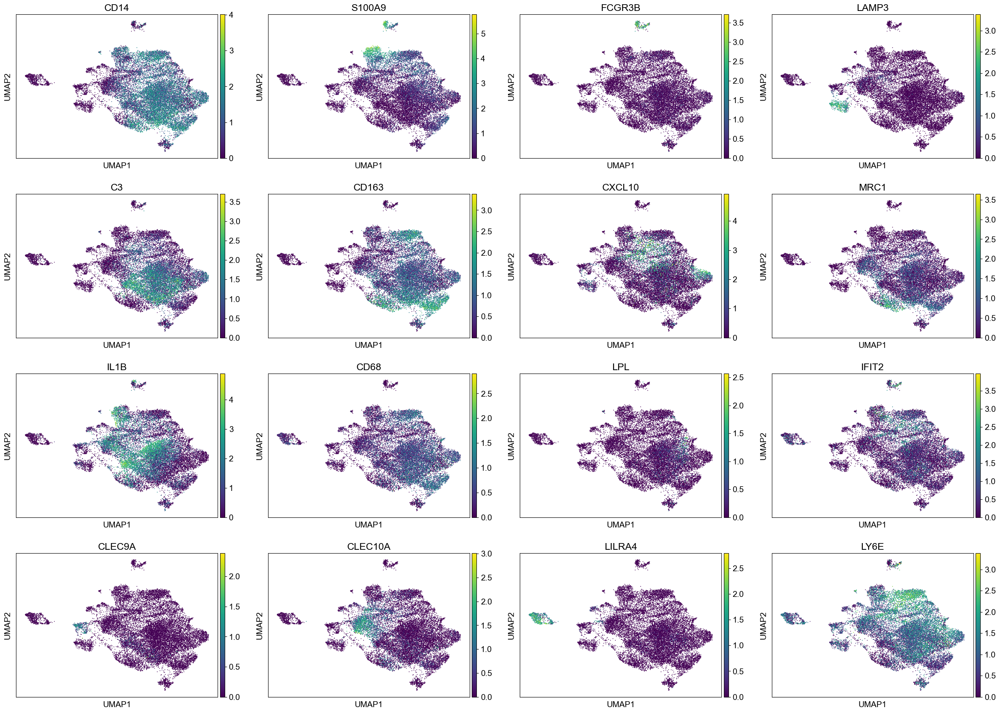

In [95]:
sc.pl.umap(adata_Mye, color=['CD14','S100A9', 'FCGR3B', 'LAMP3', 'C3', 'CD163', 'CXCL10', 
                              'MRC1', 'IL1B', 'CD68', 'LPL', 'IFIT2','CLEC9A', 'CLEC10A', 'LILRA4', 'LY6E'])

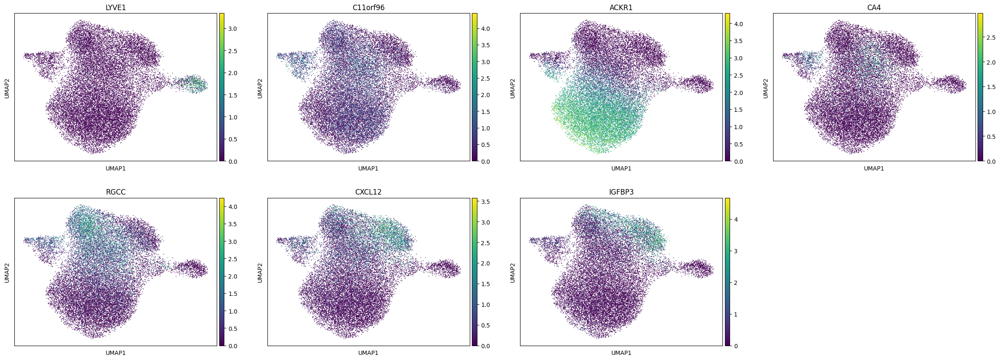

In [266]:
sc.pl.umap(adata_Endo, color=['LYVE1', 'C11orf96', 'ACKR1', 'CA4', 'RGCC', 'CXCL12', 'IGFBP3'])

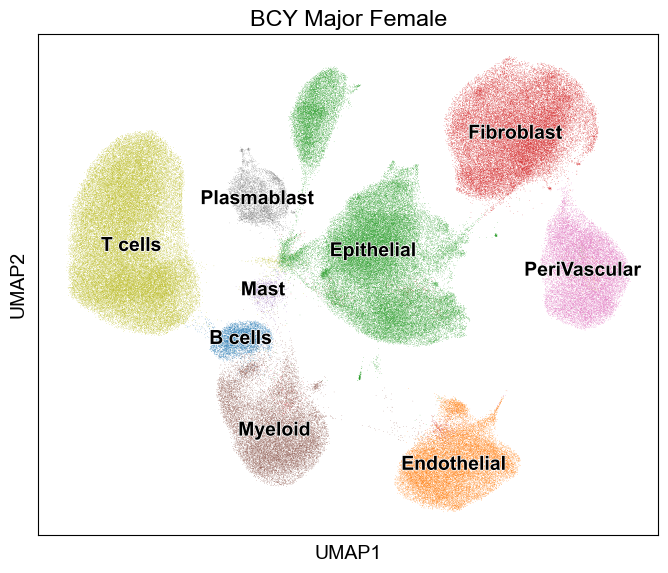

In [196]:
folder='figure-1.23/'
fig,ax = plt.subplots(figsize=(8,6.5))
adata_pdc.obs['majorPDC'] = 'Myeloid'

adata_F.obs['majorType-fix'] = list(adata_F.obs['majorType-Female'])
adata_F.obs['majorType-fix'] = MergeSubAdata(adata_F, adata_pdc, 'majorType-fix', 'majorPDC')
sc.pl.umap(adata_F, color='majorType-fix', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='BCY Major Female')
fig.savefig(folder+"majorType.png", dpi=300)

In [197]:
sc.write("adata-fixFemale.h5ad", adata_F)

In [202]:
adata_preF = adata_F[adata_F.obs['batch'].isin(['10N','10T','12N','15T','16N',
           '17T','1T','20T','21T','22T','2T','3T','5N','5T','6N','6T','8T','9T'])].copy()
adata_preF

AnnData object with n_obs × n_vars = 178891 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'dendrogram_leiden', 'gender_colors', 'hvg', 'leiden', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'minor_type_colors', 'molecular_type_colors', 'neighbors', 'pca', 'rank_genes_groups', 'scrublet', 'umap', 'major

NameError: name 'adata_preF' is not defined

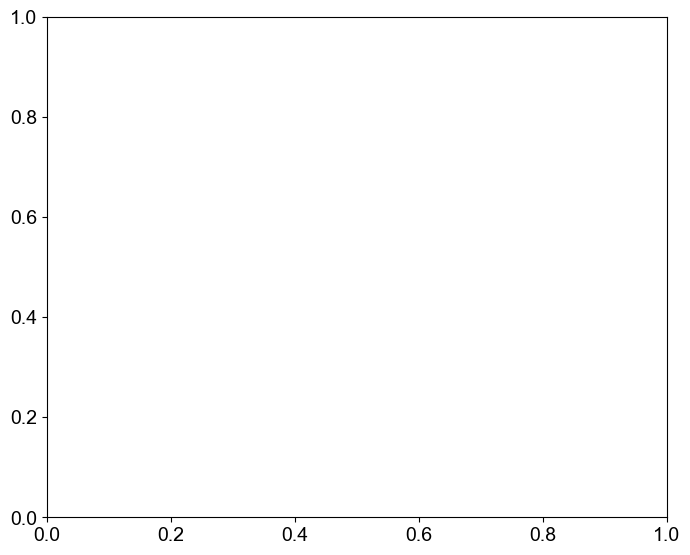

In [195]:
folder='figure-1.23/'
fig,ax = plt.subplots(figsize=(8,6.5))
sc.pl.umap(adata_preF, color='majorType-fix', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='BCY Major Female')
fig.savefig(folder+"pre-majorType.png", dpi=300)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


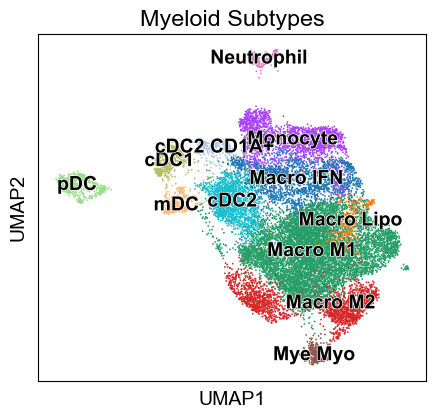

In [55]:
folder='figure-1.23/'
fig,ax = plt.subplots(figsize=(5,4.5))
sc.pl.umap(adata_Mye, color='Mye-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='Myeloid Subtypes')
fig.savefig(folder+"myeType.png", dpi=300)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


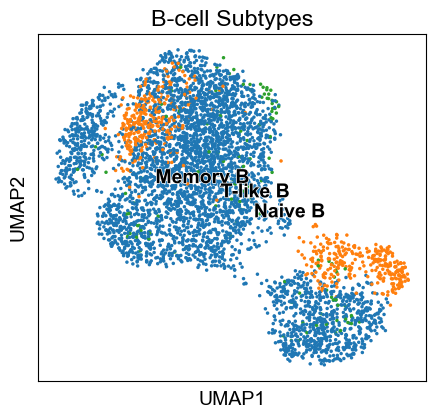

In [84]:
folder='figure-1.23/'
fig,ax = plt.subplots(figsize=(5,4.5))
sc.pl.umap(adata_B, color='B-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='B-cell Subtypes')
fig.savefig(folder+"BType.png", dpi=300)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


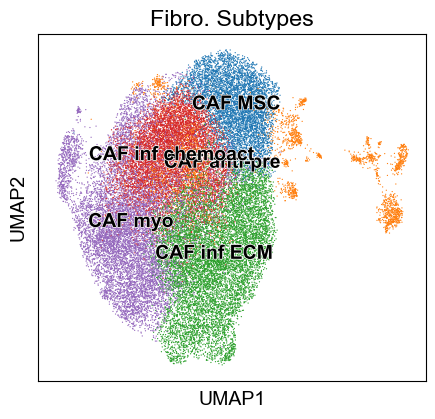

In [96]:
folder='figure-1.23/'
adata_Fib = sc.read_h5ad('adata-FFib.h5ad')
fig,ax = plt.subplots(figsize=(5,4.5))
sc.pl.umap(adata_Fib, color='Fib-type', ax=ax, 
           legend_fontoutline=True, legend_loc='on data', title='Fibro. Subtypes')
fig.savefig(folder+"fibType.png", dpi=300)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


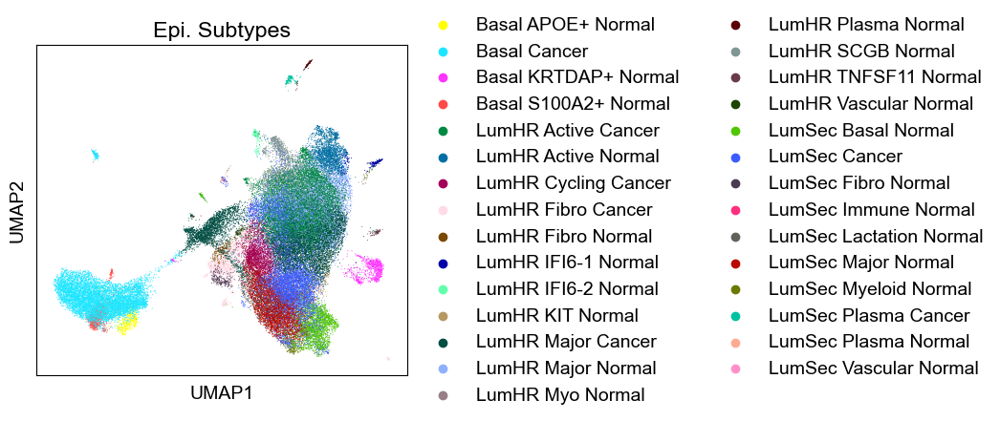

In [107]:
fig,ax = plt.subplots(figsize=(5,4.5))
sc.pl.umap(adata_epi, color='epi-subtype', ax=ax, 
           legend_fontoutline=True, title='Epi. Subtypes')
fig.savefig(folder+"epiType.png",dpi=300, bbox_inches='tight')

In [ ]:
fig,ax = plt.subplots(figsize=(5,4.5))
adata_epi_normal = sc.read_h5ad('adata-Fepi-normal.h5ad')
sc.pl.umap(adata_epi, color='epi-subtype', ax=ax, 
           legend_fontoutline=True, title='Epi. Subtypes')
fig.savefig(folder+"epiType.png",dpi=300, bbox_inches='tight')

In [108]:
adata_epi_tumor = sc.read_h5ad('adata-Fepi-tumor.h5ad')


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


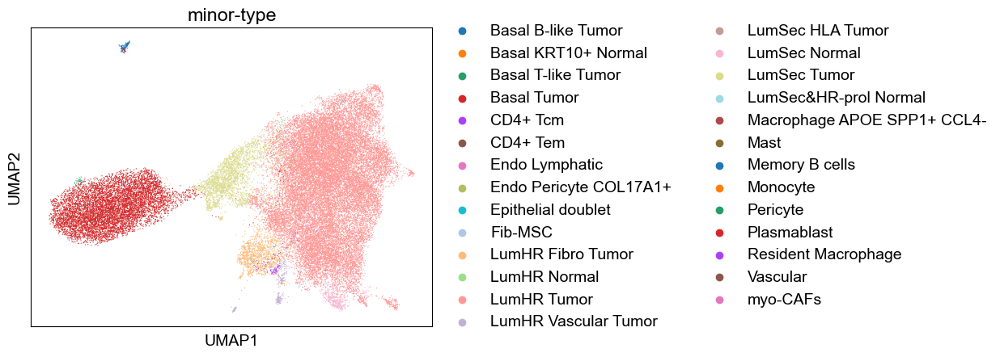

In [111]:
sc.pl.umap(adata_epi_tumor, color='minor-type')

In [114]:
adata_epi_normal = sc.read_h5ad('adata-Fepi-normal.h5ad')
adata_epi_normal

AnnData object with n_obs × n_vars = 19895 × 39735
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'leiden-epi-harmony', 'cnv_leiden', 'cnv_score', 'cnv_status', 'leiden-epi-normal'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'symbol', 'ensg', 'chromosome', 'start', 'end'
    uns: 'batch_colors', 'cnv', 'cnv_leiden_colors', 'cnv_neighbors', 'dendrogram_leiden', 'gender_colors', 'hvg', 'leiden', 'leiden-epi-harmony_colors', 'leiden-epi-normal_colors', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType